# Configuración Inicial

In [1]:
import nltk 
nltk.download('book')
from nltk.book import *
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px

[nltk_data] Downloading collection 'book'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to
[nltk_data]    |     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package brown to
[nltk_data]    |     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]    |   Package brown is already up-to-date!
[nltk_data]    | Downloading package chat80 to
[nltk_data]    |     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]    |   Package chat80 is already up-to-date!
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package conll2000 to
[nltk_data]    |     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]    |   Package conll2000 is already up-to-date!
[nltk_data]    | Downloading package conll2002 to
[nltk_data]    |     C:\Users\Tarto\AppData\R

*** Introductory Examples for the NLTK Book ***
Loading text1, ..., text9 and sent1, ..., sent9
Type the name of the text or sentence to view it.
Type: 'texts()' or 'sents()' to list the materials.
text1: Moby Dick by Herman Melville 1851
text2: Sense and Sensibility by Jane Austen 1811
text3: The Book of Genesis
text4: Inaugural Address Corpus
text5: Chat Corpus
text6: Monty Python and the Holy Grail
text7: Wall Street Journal
text8: Personals Corpus
text9: The Man Who Was Thursday by G . K . Chesterton 1908


#Bi-gramas
* Parejas de palabras que ocurren consecutivas.

In [2]:
text1 = np.char.lower(text1)
md_bigrams = list(bigrams(text1))
fdist = FreqDist(md_bigrams)
md_bigrams[:10]

[('[', 'moby'),
 ('moby', 'dick'),
 ('dick', 'by'),
 ('by', 'herman'),
 ('herman', 'melville'),
 ('melville', '1851'),
 ('1851', ']'),
 (']', 'etymology'),
 ('etymology', '.'),
 ('.', '(')]

Aqui podemos obtener los bi-gramas más frecuentes en este texto:

In [3]:
fdist.most_common(10)

[((',', 'and'), 2632),
 (('of', 'the'), 1874),
 (("'", 's'), 1796),
 (('in', 'the'), 1175),
 ((',', 'the'), 912),
 ((';', 'and'), 853),
 (('to', 'the'), 727),
 (('.', 'but'), 596),
 ((',', 'that'), 588),
 (('.', '"'), 557)]

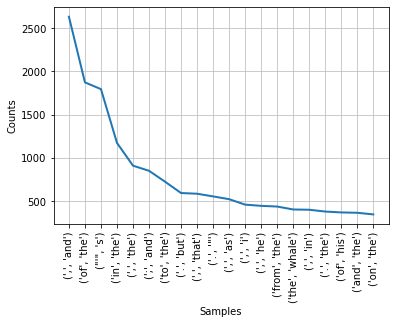

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [4]:
fdist.plot(20)

## Filtrado de bi-gramas
* Sin embargo, observamos que los bi-gramas más comunes no representan realmente frases o estructuras léxicas de interes.
* Tal vez, aplicar algun tipo de filtro nos permita ver estructuras más relevantes.

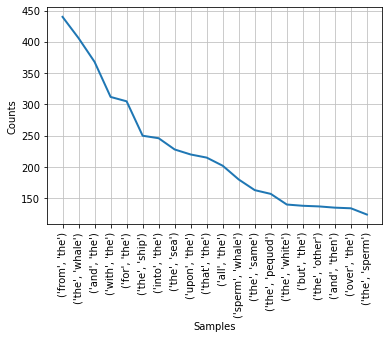

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [5]:
threshold = 2  # Minimo mayor de 2 caracteres
filtered_bigrams = [bigram for bigram in md_bigrams if len(bigram[0])>threshold and len(bigram[1])>threshold]
filtered_dist = FreqDist(filtered_bigrams)
filtered_dist.plot(20)

# Tri-gramas

In [6]:
from nltk.util import ngrams
md_trigrams = list(ngrams(text1,3))
fdist = FreqDist(md_trigrams)
md_trigrams[:10]

[('[', 'moby', 'dick'),
 ('moby', 'dick', 'by'),
 ('dick', 'by', 'herman'),
 ('by', 'herman', 'melville'),
 ('herman', 'melville', '1851'),
 ('melville', '1851', ']'),
 ('1851', ']', 'etymology'),
 (']', 'etymology', '.'),
 ('etymology', '.', '('),
 ('.', '(', 'supplied')]

In [7]:
fdist.most_common(10)

[((',', 'and', 'the'), 190),
 (('whale', "'", 's'), 125),
 (('don', "'", 't'), 119),
 (('the', 'sperm', 'whale'), 115),
 (('of', 'the', 'whale'), 109),
 (('it', "'", 's'), 100),
 (('he', "'", 's'), 98),
 (('that', "'", 's'), 94),
 ((',', 'in', 'the'), 93),
 (('the', 'white', 'whale'), 88)]

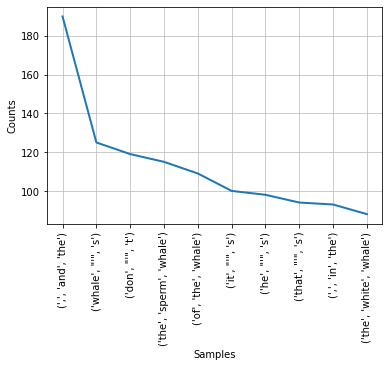

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [8]:
fdist.plot(10)

# Collocations (Colocaciones)

* Son secuencias de palabras que suelen ocurrir en textos o conversaciones con una **frecuencia inusualmente alta** [NLTK doc](http://www.nltk.org/book/ch01.html)
* Las colocaciones de una palabra son declaraciones formales de donde suele ubicarse tipicamente esa palabra [Manning & Schütze, 1990, Foundations of Statistical Natural Language Processing, Capítulo 6](https://nlp.stanford.edu/fsnlp/)

In [9]:
md_bigrams = list(bigrams(text1))

threshold = 2
#distribution of bi-grams
filtered_bigrams = [bigram for bigram in md_bigrams if len(bigram[0])>threshold and len(bigram[1])>threshold]
filtered_bigram_dist = FreqDist(filtered_bigrams)
#distribution of words
filtered_words = [word for word in text1 if len(word)>threshold]
filtered_word_dist = FreqDist(filtered_words)

# Estos comandos son MUY MUY parecidos a como se manejan los datos en "R"
df = pd.DataFrame()
df['bi_gram'] = list(set(filtered_bigrams))
df['word_0'] = df['bi_gram'].apply(lambda x: x[0])
df['word_1'] = df['bi_gram'].apply(lambda x: x[1])
df['bi_gram_freq'] = df['bi_gram'].apply(lambda x: filtered_bigram_dist[x])
df['word_0_freq'] = df['word_0'].apply(lambda x: filtered_word_dist[x])
df['word_1_freq'] = df['word_1'].apply(lambda x: filtered_word_dist[x])
df

,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq
0,"(nestling, safely)",nestling,safely,1,1,5
1,"(not, advance)",not,advance,1,1151,22
2,"(was, sinking)",was,sinking,1,1644,13
3,"(sat, frozen)",sat,frozen,1,45,10
4,"(toilet, was)",toilet,was,1,2,1644
...,...,...,...,...,...,...
65914,"(mediterranean, mariners)",mediterranean,mariners,1,9,29
65915,"(been, offered)",been,offered,1,415,12
65916,"(thrown, off)",thrown,off,2,25,220
65917,"(last, gleamed)",last,gleamed,1,277,5


# Pointwise Mutual Information (PMI)
Una métrica basada en _teoria de la información_ para encontrar **Collocations**.

$$
PMI = \log\left(\frac{P(w_1, w_2)}{P(w_1)P(w_2)}\right)
$$

In [10]:
df['PMI'] = df[['bi_gram_freq', 'word_0_freq', 'word_1_freq']].apply(lambda x:np.log2(x.values[0]/(x.values[1]*x.values[2])), axis = 1)
df['log(bi_gram_freq)'] = df['bi_gram_freq'].apply(lambda x: np.log2(x))
df

,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq,PMI,log(bi_gram_freq)
0,"(nestling, safely)",nestling,safely,1,1,5,-2.321928,0.0
1,"(not, advance)",not,advance,1,1151,22,-14.628104,0.0
2,"(was, sinking)",was,sinking,1,1644,13,-14.383434,0.0
3,"(sat, frozen)",sat,frozen,1,45,10,-8.813781,0.0
4,"(toilet, was)",toilet,was,1,2,1644,-11.682995,0.0
...,...,...,...,...,...,...,...,...
65914,"(mediterranean, mariners)",mediterranean,mariners,1,9,29,-8.027906,0.0
65915,"(been, offered)",been,offered,1,415,12,-12.281930,0.0
65916,"(thrown, off)",thrown,off,2,25,220,-11.425216,1.0
65917,"(last, gleamed)",last,gleamed,1,277,5,-10.435670,0.0


In [11]:
df.sort_values(by = 'PMI', ascending=False)

,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq,PMI,log(bi_gram_freq)
37555,"(riotously, perverse)",riotously,perverse,1,1,1,0.000000,0.0
37919,"(magniloquent, ascriptions)",magniloquent,ascriptions,1,1,1,0.000000,0.0
37938,"(wery, woracious)",wery,woracious,1,1,1,0.000000,0.0
38018,"(unsurrenderable, wilfulness)",unsurrenderable,wilfulness,1,1,1,0.000000,0.0
38230,"(maidenly, gentleness)",maidenly,gentleness,1,1,1,0.000000,0.0
...,...,...,...,...,...,...,...,...
17149,"(ship, the)",ship,the,1,518,14431,-22.833692,0.0
64052,"(some, the)",some,the,1,618,14431,-23.088347,0.0
35474,"(one, the)",one,the,1,921,14431,-23.663941,0.0
26538,"(the, not)",the,not,1,14431,1151,-23.985556,0.0


In [12]:
fig = px.scatter(x = df['PMI'].values, y = df['log(bi_gram_freq)'].values, 
                 color = df['PMI']+df['log(bi_gram_freq)'], 
                 size = (df['PMI']+df['log(bi_gram_freq)']).apply(lambda x: 1/(1+abs(x))).values, 
                 hover_name = df['bi_gram'].values, 
                 width = 600, 
                 height = 600, 
                 labels = {'x': 'PMI', 'y': 'Log(Bigram Frequency)'})
fig.show()

# Medidas pre-construidas en NLTK

In [13]:
# ver documentación https://www.nltk.org/_modules/nltk/metrics/association.html
from nltk.collocations import *
bigram_measures = nltk.collocations.BigramAssocMeasures()
finder = BigramCollocationFinder.from_words(text1)

In [14]:
finder.apply_freq_filter(20)
finder.nbest(bigram_measures.pmi, 10)

[('moby', 'dick'),
 ('thou', 'art'),
 (',"', 'said'),
 ('never', 'mind'),
 ('captain', 'peleg'),
 ('!"', 'cried'),
 ('no', 'doubt'),
 ('no', 'means'),
 ('each', 'other'),
 (',"', 'cried')]

# Textos en Español 

In [15]:
# descargamos corpus en español  https://mailman.uib.no/public/corpora/2007-October/005448.html
nltk.download('cess_esp')
corpus = nltk.corpus.cess_esp.sents() 
flatten_corpus = [w for l in corpus for w in l]

[nltk_data] Downloading package cess_esp to
[nltk_data]     C:\Users\Tarto\AppData\Roaming\nltk_data...
[nltk_data]   Package cess_esp is already up-to-date!


In [16]:
print(corpus[0])

['El', 'grupo', 'estatal', 'Electricité_de_France', '-Fpa-', 'EDF', '-Fpt-', 'anunció', 'hoy', ',', 'jueves', ',', 'la', 'compra', 'del', '51_por_ciento', 'de', 'la', 'empresa', 'mexicana', 'Electricidad_Águila_de_Altamira', '-Fpa-', 'EAA', '-Fpt-', ',', 'creada', 'por', 'el', 'japonés', 'Mitsubishi_Corporation', 'para', 'poner_en_marcha', 'una', 'central', 'de', 'gas', 'de', '495', 'megavatios', '.']


In [17]:
print(flatten_corpus[:50])

['El', 'grupo', 'estatal', 'Electricité_de_France', '-Fpa-', 'EDF', '-Fpt-', 'anunció', 'hoy', ',', 'jueves', ',', 'la', 'compra', 'del', '51_por_ciento', 'de', 'la', 'empresa', 'mexicana', 'Electricidad_Águila_de_Altamira', '-Fpa-', 'EAA', '-Fpt-', ',', 'creada', 'por', 'el', 'japonés', 'Mitsubishi_Corporation', 'para', 'poner_en_marcha', 'una', 'central', 'de', 'gas', 'de', '495', 'megavatios', '.', 'Una', 'portavoz', 'de', 'EDF', 'explicó', 'a', 'EFE', 'que', 'el', 'proyecto']


In [18]:
finder = BigramCollocationFinder.from_documents(corpus)
finder.apply_freq_filter(10)
finder.nbest(bigram_measures.pmi, 10)

[('señora', 'Aguirre'),
 ('secretario', 'general'),
 ('elecciones', 'generales'),
 ('campaña', 'electoral'),
 ('quiere', 'decir'),
 ('Se', 'trata'),
 ('segunda', 'vuelta'),
 ('director', 'general'),
 ('primer', 'ministro'),
 ('primer', 'lugar')]

# Referencias para seguir aprendiendo


*   [Mas sobre Colocaciones con NLTK](http://www.nltk.org/howto/collocations.html)
*   

